In [2]:
import pandas as pd
import plotly.express as px

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
import numpy as np
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report
from sklearn.tree import export_graphviz
from IPython.display import Image
from subprocess import call
import shap
from xgboost import plot_tree, plot_importance

with open('token.txt', 'r') as f:
    TOKEN = f.read()
    px.set_mapbox_access_token(TOKEN)

In [3]:
df = pd.read_parquet('../django-api/api/fires_merged.parquet')

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 580029 entries, 0 to 580028
Data columns (total 15 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   latitude    580029 non-null  float64       
 1   longitude   580029 non-null  float64       
 2   brightness  580029 non-null  float64       
 3   scan        580029 non-null  float64       
 4   track       580029 non-null  float64       
 5   acq_date    580029 non-null  datetime64[ns]
 6   acq_time    580029 non-null  int64         
 7   satellite   580029 non-null  object        
 8   instrument  580029 non-null  object        
 9   confidence  580029 non-null  object        
 10  version     580029 non-null  object        
 11  bright_t31  580029 non-null  float64       
 12  frp         580029 non-null  float64       
 13  daynight    580029 non-null  object        
 14  type        367685 non-null  float64       
dtypes: datetime64[ns](1), float64(8), int64(1), object(

In [5]:
# Get df with type not null
df_archive = df[df['type'].notnull()]

In [6]:
df_archive.acq_date.min(), df_archive.acq_date.max()

(Timestamp('2013-01-01 00:00:00'), Timestamp('2023-01-31 00:00:00'))

In [7]:
a = df_archive[['latitude', 'longitude', 'acq_date', 'type', 'frp']].copy()
fig = px.scatter_mapbox(a[a['type'] == 1], lat="latitude", lon="longitude", color='frp', size='frp', zoom=3, title='Wildfires')
fig.update_layout(mapbox_style='satellite', title='Clusters Analysis for Volcanoes', height=800)
fig.show()

In [8]:
fig = px.scatter_mapbox(a[a['type'] == 2], lat="latitude", lon="longitude", zoom=3, color='frp', size='frp', title='Wildfires')
fig.update_layout(mapbox_style='satellite', title='Clusters Analysis for Static land source', height=800)
fig.show()

In [9]:
fig = px.scatter_mapbox(a[a['type'] == 3], lat="latitude", lon="longitude", zoom=3, color='frp', size='frp', title='Wildfires')
fig.update_layout(mapbox_style='satellite', title='Clusters Analysis for Offshore detection', height=800)
fig.show()

In [10]:
fig = px.scatter_mapbox(a[a['type'] == 0], lat="latitude", lon="longitude", zoom=3, color='frp', size='frp', title='Wildfires')
fig.update_layout(mapbox_style='satellite', title='Clusters Analysis for Wildfires', height=800)
fig.show()

In [11]:
wildfires = df_archive[df_archive['type'] == 0]
volcanoes = df_archive[df_archive['type'] == 1]
static_land = df_archive[df_archive['type'] == 2]
offshore = df_archive[df_archive['type'] == 3]

# Get mean of frp for each type

wildfires_mean = wildfires['frp'].mean()
volcanoes_mean = volcanoes['frp'].mean()
static_land_mean = static_land['frp'].mean()
offshore_mean = offshore['frp'].mean()

# Print frp
print('Wildfires mean frp: ', wildfires_mean)
print('Volcanoes mean frp: ', volcanoes_mean)
print('Static land mean frp: ', static_land_mean)
print('Offshore mean frp: ', offshore_mean)

Wildfires mean frp:  30.487008922376713
Volcanoes mean frp:  11.60112113402062
Static land mean frp:  7.381173743714942
Offshore mean frp:  6.73798424260443


In [12]:
wildfires['frp'].describe()

count    288264.000000
mean         30.487009
std         120.536752
min           0.000000
25%           3.420000
50%           8.070000
75%          22.520000
max       12844.800000
Name: frp, dtype: float64

In [13]:
volcanoes['frp'].describe()

count    3880.000000
mean       11.601121
std        72.622975
min         0.150000
25%         1.520000
50%         2.670000
75%         7.020000
max      1704.600000
Name: frp, dtype: float64

In [14]:
static_land['frp'].describe()

count    68814.000000
mean         7.381174
std         17.727623
min          0.000000
25%          2.420000
50%          4.900000
75%          8.610000
max       2918.100000
Name: frp, dtype: float64

In [15]:
offshore['frp'].describe()

count    6727.000000
mean        6.737984
std        18.133167
min         0.000000
25%         1.370000
50%         2.410000
75%         5.500000
max       517.600000
Name: frp, dtype: float64

There's clearly class imbalance, but because I only care on class 0, let's make another experiment where I consider the other types as 1.

Also the model becomes way more complex with multiple classes.

In [16]:
df_binary = df_archive.copy()
# The other types different than 0, make them 1
df_binary['type'] = df_binary['type'].apply(lambda x: 1 if x != 0 else 0)
df_binary['daynight'] = df_binary['daynight'].apply(lambda x: 1 if x != 'D' else 0)

# Encode categorical variables
df_binary['satellite'] = df_binary['satellite'].apply(lambda x: 0 if x == 'N' else 1 if x == 'Aqua' else 2)
df_binary['confidence'] = df_binary['confidence'].apply(lambda x: 0 if x == 'l' else 1 if x == 'n' else 2 if x == 'h' else 3)

# Log frp
#df_binary['frp'] = df_binary['frp'].apply(lambda x: np.log1p(x))

In [17]:
test_points = [
    # Huachipato
    {
        "id": 613,
        "latitude": -36.74376,
        "longitude": -73.12938,
        "brightness": 298.91,
        "scan": 0.57,
        "track": 0.52,
        "acq_date": "2024-01-11",
        "acq_time": 629,
        "satellite": "N",
        "instrument": "VIIRS",
        "confidence": "n",
        "version": "2.0NRT",
        "bright_t31": 285.38,
        "frp": 0.94,
        "daynight": "N",
        "ftype": None
    },
    # Incendio
    {
        "id": 674,
        "latitude": -34.51119,
        "longitude": -71.11005,
        "brightness": 337.26,
        "scan": 0.47,
        "track": 0.4,
        "acq_date": "2024-01-11",
        "acq_time": 1849,
        "satellite": "N",
        "instrument": "VIIRS",
        "confidence": "l",
        "version": "2.0NRT",
        "bright_t31": 309.17,
        "frp": 57.67,
        "daynight": "D",
        "ftype": None
    },
    # Incendio
    {
        "id": 675,
        "latitude": -34.50848,
        "longitude": -71.11604,
        "brightness": 316.3,
        "scan": 0.47,
        "track": 0.4,
        "acq_date": "2024-01-11",
        "acq_time": 1849,
        "satellite": "N",
        "instrument": "VIIRS",
        "confidence": "l",
        "version": "2.0NRT",
        "bright_t31": 318.45,
        "frp": 25.33,
        "daynight": "D",
        "ftype": None
    },
    # Volcan
    {
        "id": 587,
        "latitude": -39.42002,
        "longitude": -71.94642,
        "brightness": 333.22,
        "scan": 1.02,
        "track": 1.01,
        "acq_date": "2024-01-11",
        "acq_time": 304,
        "satellite": "Terra",
        "instrument": "MODIS",
        "confidence": "h",
        "version": "6.1NRT",
        "bright_t31": 271.28,
        "frp": 39.51,
        "daynight": "N",
        "ftype": None
    },
]

In [35]:
train_data = df_binary[df_binary['acq_date'] < '2020-01-01'].copy()
test_data = df_binary[df_binary['acq_date'] >= '2020-01-01'].copy()

#train_data['frp'].apply(np.log1p)
#test_data['frp'].apply(np.log1p)

features = ['frp', 'track', 'daynight', 'confidence', 'latitude', 'longitude']

X_train = train_data[features]
y_train = train_data['type']

X_test = test_data[features]
y_test = test_data['type']

In [36]:
import xgboost as xgb

# Convert the data to DMatrix format
dtrain = xgb.DMatrix(X_train, label=y_train)
dtest = xgb.DMatrix(X_test, label=y_test)

# Set the parameters for XGBoost
params = {
    'objective': 'binary:logistic',
    'eval_metric': 'logloss',
    'max_depth': 6,
    'eta': 0.1,
    'subsample': 0.8,
    'colsample_bytree': 0.8,
    'lambda': 1,
    'alpha': 0.2
}

# Train the XGBoost model
num_rounds = 100
model = xgb.train(params, dtrain, num_rounds)

# Make predictions on the test data
y_pred = model.predict(dtest)
y_pred_binary = [1 if pred >= 0.5 else 0 for pred in y_pred]

# Evaluate the model
accuracy = np.mean(y_pred_binary == y_test)
print(f"Accuracy: {accuracy}")

Accuracy: 0.9514470420986002


In [37]:
# Cross validation
cv_results = xgb.cv(params, dtrain, num_rounds, nfold=5, metrics='logloss', seed=123)
print(cv_results)

    train-logloss-mean  train-logloss-std  test-logloss-mean  test-logloss-std
0             0.621168           0.000118           0.621218          0.000297
1             0.560572           0.001423           0.560778          0.001320
2             0.509165           0.000841           0.509398          0.000988
3             0.468966           0.007915           0.469285          0.007858
4             0.430315           0.006663           0.430637          0.006549
..                 ...                ...                ...               ...
95            0.087096           0.001064           0.091444          0.001726
96            0.086730           0.001088           0.091140          0.001775
97            0.086469           0.001082           0.090914          0.001799
98            0.086184           0.001094           0.090662          0.001791
99            0.085826           0.001106           0.090333          0.001783

[100 rows x 4 columns]


In [38]:
# Predict test points

new_data = pd.DataFrame(test_points)
new_data = new_data[features]

# IF log frp
#new_data['frp'] = new_data['frp'].apply(lambda x: np.log1p(x))

if 'daynight' in new_data.columns:
    new_data['daynight'] = new_data['daynight'].apply(lambda x: 1 if x != 'D' else 0)
    new_data['daynight'] = new_data['daynight'].astype(int)
if 'satellite' in new_data.columns:
    new_data['satellite'] = new_data['satellite'].apply(lambda x: 0 if x == 'N' else 1 if x == 'Aqua' else 2)
    new_data['satellite'] = new_data['satellite'].astype(int)
if 'confidence' in new_data.columns:
    new_data['confidence'] = new_data['confidence'].apply(lambda x: 0 if x == 'l' else 1 if x == 'n' else 2 if x == 'h' else 3)
    new_data['confidence'] = new_data['confidence'].astype(int)

new_data_dmatrix = xgb.DMatrix(new_data)

new_data_pred = model.predict(new_data_dmatrix)

new_data_pred

array([0.9665896 , 0.00370638, 0.00447151, 0.9031186 ], dtype=float32)

In [22]:
# 0 = Wildfire, 1 = Non-Wildfire
# NORMAL            array([0.88867766, 0.00867324, 0.01978689, 0.5225017 ], dtype=float32)
# daynight          array([0.9111269 , 0.00813729, 0.0165807 , 0.5395553 ], dtype=float32)
# scan              array([0.90972126, 0.0053113 , 0.00889201, 0.3893062 ], dtype=float32)
# scan + daynight   array([0.9126747 , 0.00457533, 0.00715487, 0.670395  ], dtype=float32)
# brightness        array([0.9384211 , 0.0080309 , 0.04846816, 0.53369176], dtype=float32)
# track             array([0.9241813 , 0.00406192, 0.00901783, 0.4085651 ], dtype=float32)
# all               array([0.90557915, 0.00647287, 0.01710766, 0.73214626], dtype=float32)

# Log frp depth 5   array([0.9254661 , 0.00602511, 0.0123836 , 0.7397304 ], dtype=float32)
# depth 6           array([0.9698877 , 0.00450013, 0.00656835, 0.72343606], dtype=float32)

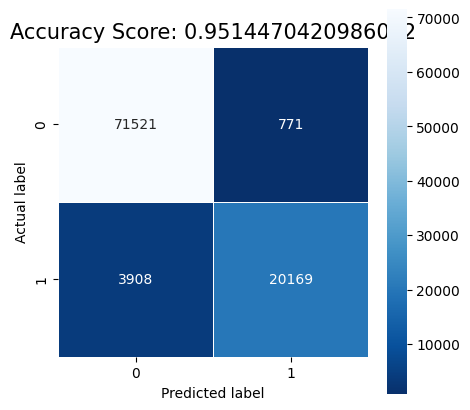

In [39]:
# Load confusion matrix and metrics
cm = confusion_matrix(y_test, y_pred_binary)

#plot
plt.figure(figsize=(5, 5))
sns.heatmap(cm, annot=True, fmt=".0f", linewidths=.5, square=True, cmap='Blues_r')
plt.ylabel('Actual label')
plt.xlabel('Predicted label')
plt.title(f'Accuracy Score: {accuracy}', size=15)
plt.show()


In [40]:
# Precision, Recall, F1-Score
print(classification_report(y_test, y_pred_binary))

              precision    recall  f1-score   support

           0       0.95      0.99      0.97     72292
           1       0.96      0.84      0.90     24077

    accuracy                           0.95     96369
   macro avg       0.96      0.91      0.93     96369
weighted avg       0.95      0.95      0.95     96369



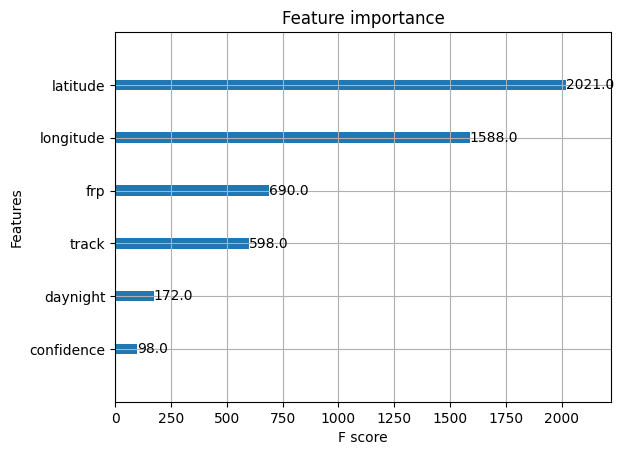

In [41]:
# Plot feature importances
xgb.plot_importance(model)
plt.show()

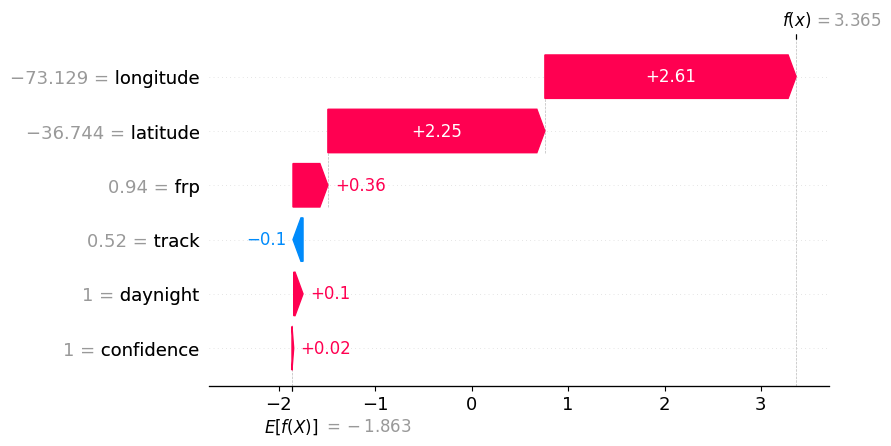

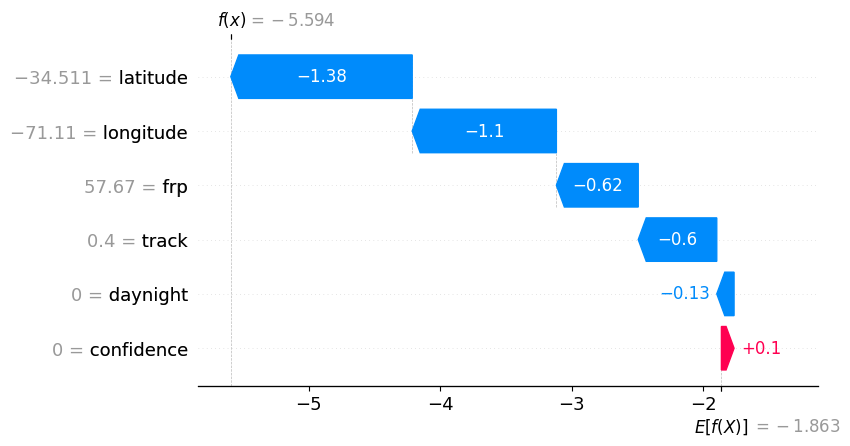

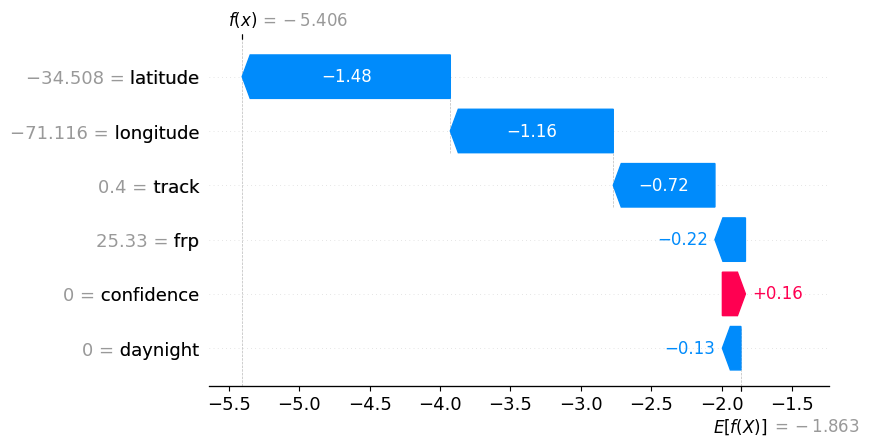

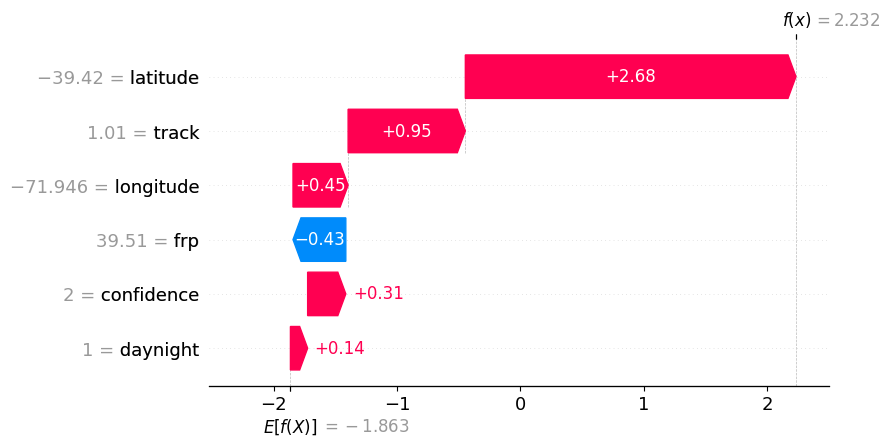

In [42]:
explainer = shap.Explainer(model)
shap_values = explainer(new_data)


for i in range(len(new_data)):
    shap.plots.waterfall(shap_values[i])


<AxesSubplot: >

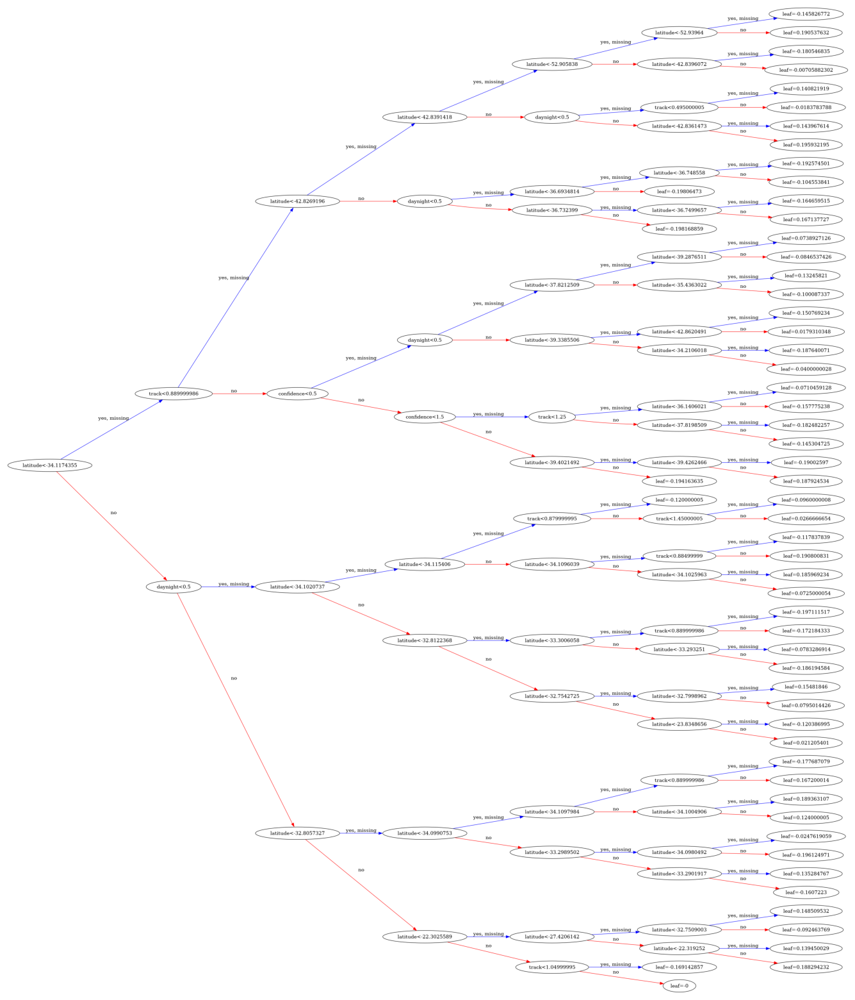

In [27]:
fig, ax = plt.subplots(figsize=(20, 20))
plot_tree(model, rankdir='LR', num_trees=0, ax=ax)

In [28]:
model.save_model('xgb_model.json')

# Visualize latest fires after prediction

In [30]:
test_data_result = pd.read_csv('test_data_result.csv')
test_data_result.head()

,frp,track,daynight,confidence,latitude,longitude,ftype
0,0.73,0.44,1,1,-34.32245,-70.73393,0
1,6.41,0.44,1,1,-34.10534,-70.45562,1
2,2.06,0.45,1,1,-33.29236,-70.72990,1
3,1.93,0.46,1,1,-32.80292,-70.95407,1
4,37.66,0.43,1,1,-39.41776,-71.94116,1


In [43]:
a = test_data_result[['latitude', 'longitude', 'ftype', 'frp']].copy()
fig = px.scatter_mapbox(a, lat="latitude", lon="longitude", color='ftype', size='frp', zoom=3, title='Wildfires')
fig.update_layout(mapbox_style='satellite', title='Model prediction visualization', height=800)
fig.show()